Video Anomaly Detection

## Import required Python libraries

In [1]:
import tensorflow as tf
# import glob
# import numpy as np
# from PIL import Image
# import matplotlib.pyplot as plt
# import matplotlib
import os
# from utils import display_images
# from utils import create_gif
# from utils import download_data
# from utils import get_run_logdir
# from utils import plot_reconstruction_loss
# from utils import create_losses_animation
# from utils import plot_image
from utils import *
from IPython.display import display
from IPython.display import Image as ipyImage
from dataset_util import prepare_dataset


In [2]:
## Uncomment the following if you encounter CUDA memory error

config = tf.compat.v1.ConfigProto()
config.gpu_options.allow_growth = True
config.log_device_placement = True

sess = tf.compat.v1.Session(config=config)
tf.compat.v1.keras.backend.set_session(sess)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device
/job:localhost/replica:0/task:0/device:GPU:0 -> device: 0, name: GeForce GTX 1650 Ti, pci bus id: 0000:01:00.0, compute capability: 7.5
/job:localhost/replica:0/task:0/device:XLA_GPU:0 -> device: XLA_GPU device



## Dataset 

**UCSD Anomaly Detection Dataset**

The UCSD Anomaly Detection Dataset was acquired with a stationary camera mounted at an elevation, overlooking pedestrian walkways. The crowd density in the walkways was variable, ranging from sparse to very crowded. In the normal setting, the video contains only pedestrians. Abnormal events are due to either:
- the circulation of non pedestrian entities in the walkways
- anomalous pedestrian motion patterns

Commonly occurring anomalies include bikers, skaters, small carts, and people walking across a walkway or in the grass that surrounds it. A few instances of people in wheelchair were also recorded. All abnormalities are naturally occurring, i.e. they were not staged for the purposes of assembling the dataset. The data was split into 2 subsets, each corresponding to a different scene. The video footage recorded from each scene was split into various clips of around 200 frames.

- Peds1: clips of groups of people walking towards and away from the camera, and some amount of perspective distortion. Contains 34 training video samples and 36 testing video samples.

- Peds2: scenes with pedestrian movement parallel to the camera plane. Contains 16 training video samples and 12 testing video samples.



### Download the Dataset

In [3]:
url = 'https://sdaaidata.s3-ap-southeast-1.amazonaws.com/UCSD_Anomaly_Dataset.v1p2.zip'
download_data(url, extract=True, force=False)

dataset directory already exists, skip download


In [4]:
# For now we use the UCSDped1 dataset.
# Change this to UCSDped2 if you want to experiment with another dataset
dataset = 'UCSDped1'

# setup all the relative path
root_path = os.path.join('UCSD_Anomaly_Dataset.v1p2', dataset)
train_dir = os.path.join(root_path, 'Train')
test_dir = os.path.join(root_path, 'Test')

The UCSD dataset is split into two sets: one for training, and one for testing. 
The training data (consists of 24 video clips) are in Train subfolder. Each clip is in a separate subfolder 'Train001', 'Train002', etc, and each folder consists 200 image frame.

### Visualize the Train dataset

Our training set contains only video scenes that are 'normal'. Let's look at the few examples. 

You can change the train_sample_folder to another folder e.g. Train010, Train200, etc. 

range(1,9) allows you to view 

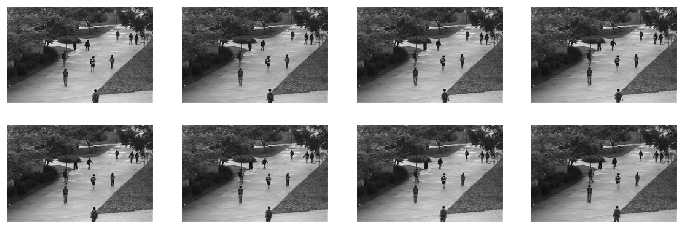

In [5]:
# You can change the following train_sample_folder to another folder to view other clips
train_sample_folder = 'Train034' 
image_range = (1,9)  # this display image from 1 to 8
image_folder = os.path.join(train_dir, train_sample_folder)
display_images(image_folder, image_range=image_range, max_per_row=4)

#### Visualize as animated gif
Here we will convert the image frames to video (as animated gif) for easier viewing. The video consists of 200 frames. From the navigation panel, you will see that a gif file called `<train_sample_folder_name>.gif` has been created, e.g. `Train001.gif`.

In [6]:
gif_filename = train_sample_folder + '.gif' 
create_gif(image_folder, gif_filename, img_type='tif')

Now we play the video

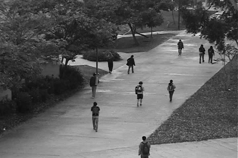

In [7]:
with open(gif_filename,'rb') as file:
    display(ipyImage(file.read(), format='png'))

## Visualize the Test dataset

Now do the same for the Train dataset

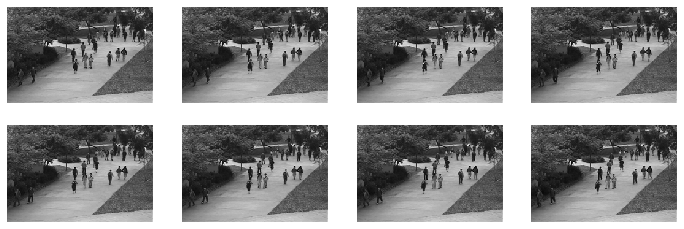

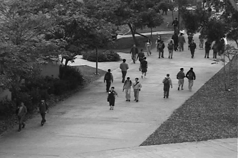

In [8]:
test_sample_folder = 'Test001' 
image_range = (1,9)  # this display image from 1 to 8
image_folder = os.path.join(test_dir, test_sample_folder)
display_images(image_folder, image_range=image_range, max_per_row=4)

gif_filename = train_sample_folder + '.gif' 
create_gif(image_folder, gif_filename, img_type='tif')

with open(gif_filename,'rb') as file:
    display(ipyImage(file.read(), format='png'))

### Prepare Training Dataset

Here we create a tensorflow dataset suitable for use in training the Autoencoder network later.

In [9]:
IMG_HEIGHT=100
IMG_WIDTH=100
BATCH_SIZE=16

train_fileset = os.path.join(train_dir, '*/*.tif')
train_dataset = prepare_dataset(train_fileset,
                                img_height=IMG_HEIGHT, 
                                img_width=IMG_WIDTH, 
                                batch_size=BATCH_SIZE,
                                shuffle=True)

In [10]:
# We have a total of 34 x 200 = 6800 images. 
# As each training batch is 16 images, we have a total of 6800/16=425 batches of images 
print(len(list(train_dataset)))

425


### Building the Auto-encoder Model

Explain what auto-encoder is and how it looks like

![autoencoder](resources/autoencoder.png)

**Exercise**:

Try changing the Dense layer below to higher or lower number.

In [30]:
# The encoder part of the Audo-encoder model
inputs = tf.keras.layers.Input(shape=(100,100,1))
x = tf.keras.layers.Conv2D(32, kernel_size=5, activation='relu')(inputs)
x = tf.keras.layers.MaxPool2D(pool_size=2)(x)
x = tf.keras.layers.Conv2D(32, kernel_size=5, activation='relu')(x)
x = tf.keras.layers.MaxPool2D(pool_size=2)(x)
x = tf.keras.layers.Flatten()(x)
encoded = tf.keras.layers.Dense(2000)(x)
encoder = tf.keras.Model(inputs=[inputs], outputs=[encoded])

# The decoder part of the Audo-encoder model
decoder_inputs = tf.keras.layers.Input(shape=(2000))
x = tf.keras.layers.Dense(22*22*32, activation='relu')(decoder_inputs)
x = tf.keras.layers.Reshape(target_shape=(22,22,32))(x)
x = tf.keras.layers.UpSampling2D(2, interpolation='nearest')(x)
x = tf.keras.layers.Conv2DTranspose(32, kernel_size=5, activation='relu')(x)
x = tf.keras.layers.UpSampling2D(2, interpolation='nearest')(x)
decoded = tf.keras.layers.Conv2DTranspose(1, kernel_size=5, activation='sigmoid')(x)
decoder = tf.keras.Model(inputs=[decoder_inputs], outputs=[decoded])


# stacked_ae = tf.keras.Model(inputs=[inputs], outputs=[decoded])
# stacked_ae.summary()
# decoder = tf.keras.Model(inputs=[decoder_inputs], outputs=[x])
# encoder = tf.keras.Model(inputs=[inputs], outputs=[x])
# encoder.summary()


Model: "functional_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 100, 100, 1)]     0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 96, 96, 32)        832       
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 48, 48, 32)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 44, 44, 32)        25632     
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 22, 22, 32)        0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 15488)             0         
_________________________________________________________________
dense_2 (Dense)              (None, 2000)             

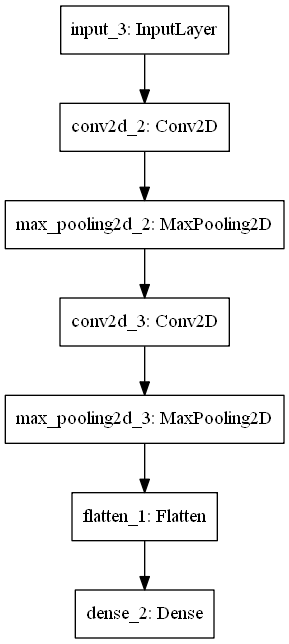

In [31]:
encoder.summary()
tf.keras.utils.plot_model(encoder)

Model: "functional_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 2000)]            0         
_________________________________________________________________
dense_3 (Dense)              (None, 15488)             30991488  
_________________________________________________________________
reshape_1 (Reshape)          (None, 22, 22, 32)        0         
_________________________________________________________________
up_sampling2d_2 (UpSampling2 (None, 44, 44, 32)        0         
_________________________________________________________________
conv2d_transpose_2 (Conv2DTr (None, 48, 48, 32)        25632     
_________________________________________________________________
up_sampling2d_3 (UpSampling2 (None, 96, 96, 32)        0         
_________________________________________________________________
conv2d_transpose_3 (Conv2DTr (None, 100, 100, 1)      

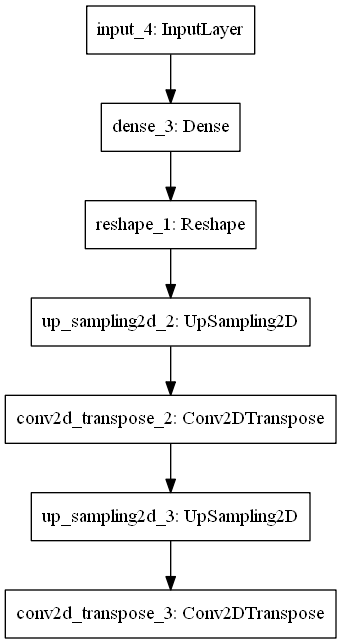

In [32]:
decoder.summary()
tf.keras.utils.plot_model(decoder)

In [33]:
# stacked_ae = tf.keras.Sequential([encoder, decoder])
encoding = encoder(inputs)
decoding = decoder(encoding)
conv_ae = tf.keras.Model(inputs=[inputs], outputs=[decoding])

In [34]:
conv_ae.summary()

Model: "functional_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 100, 100, 1)]     0         
_________________________________________________________________
functional_7 (Functional)    (None, 2000)              31004464  
_________________________________________________________________
functional_9 (Functional)    (None, 100, 100, 1)       31017921  
Total params: 62,022,385
Trainable params: 62,022,385
Non-trainable params: 0
_________________________________________________________________


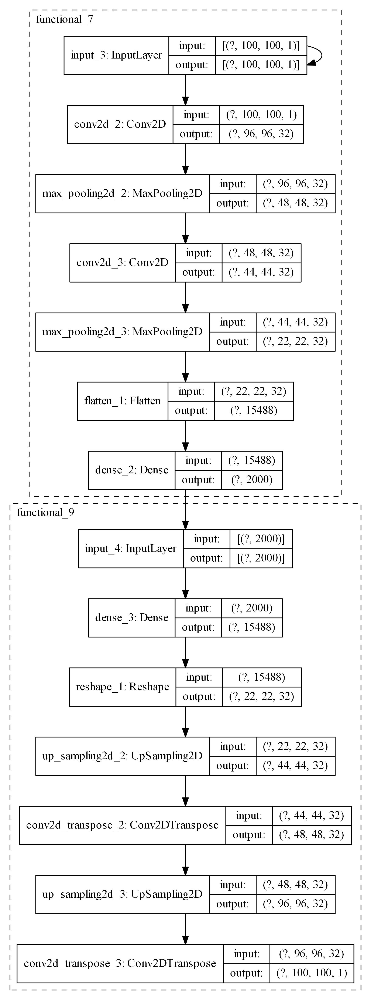

In [35]:
tf.keras.utils.plot_model(conv_ae, to_file='model.png', expand_nested=True,show_shapes=True, dpi=282)

In [36]:
conv_ae.compile(loss=tf.keras.losses.MeanSquaredError(), 
        optimizer=tf.keras.optimizers.Adam(lr=1e-4, decay=1e-4),
        metrics=['mae'])



In [37]:
train = True
num_epochs = 50

if train:     
    run_logdir = get_run_logdir() # e.g., './my_logs/run_2019_06_07-15_15_22'
    tensorboard_cb = tf.keras.callbacks.TensorBoard(run_logdir)
    history = conv_ae.fit(train_dataset, epochs=num_epochs, callbacks=[tensorboard_cb])
    conv_ae.save('trained_model')
else:
    conv_ae = tf.keras.models.load_model('trained_model')

Epoch 1/50
  1/425 [..............................] - ETA: 0s - loss: 0.0570 - mae: 0.2137WARNING:tensorflow:From C:\Users\kheng\anaconda3\envs\tf2env\lib\site-packages\tensorflow\python\ops\summary_ops_v2.py:1277: stop (from tensorflow.python.eager.profiler) is deprecated and will be removed after 2020-07-01.
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
425/425 [==============================] - 16s 38ms/step - loss: 0.0062 - mae: 0.0442
Epoch 2/50
425/425 [==============================] - 17s 39ms/step - loss: 0.0036 - mae: 0.0306
Epoch 3/50
425/425 [==============================] - 17s 40ms/step - loss: 0.0027 - mae: 0.0269
Epoch 4/50
425/425 [==============================] - 17s 40ms/step - loss: 0.0021 - mae: 0.0242
Epoch 5/50
425/425 [==============================] - 17s 41ms/step - loss: 0.0018 - mae: 0.0220
Epoch 6/50
425/425 [==============================] - 18s 42ms/step - loss: 0.0015 - mae: 0.0203
Epoch 7/50
425/425 [=========================

In [38]:
if train:
    plot_training_loss(history)

KeyError: 'val_loss'

In [39]:
# def plot_image(image):
#     print('plot image {}'.format(image.shape))
#     plt.imshow(image[:,:,0], cmap=plt.cm.gray, interpolation='nearest')
#     plt.axis("off")

In [40]:

sample_train_image = os.path.join(train_dir, 'Train001/001.tif')
sample_test_image = os.path.join(test_dir, 'Test024/140.tif')
print(sample_test_image)

UCSD_Anomaly_Dataset.v1p2\UCSDped1\Test\Test024/140.tif


Now we will take a 'normal' image from the train set, and see how well the autoencoder reconstructs it. We will plot the original image on the left and the reconstructed image on the righ. 

Here you can see that it can mostly reconstruct the original image (the left)

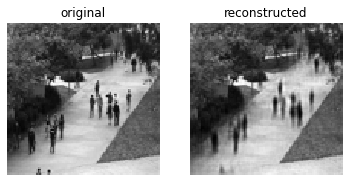

In [41]:
show_reconstructions(conv_ae, sample_train_image)

Let's look at the 'abnormal' image from the test set where a cart can be seen driving through the walkway.  

Since the cart is something that the autoencoder has never seen before, it failed to reconstruct it properly. 

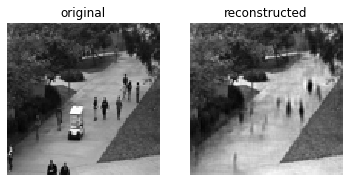

In [42]:
show_reconstructions(conv_ae, sample_test_image)

Let's us look at how the reconstruction loss varies for each video frames. Here you can clearly see that the loss starting to spike after the cart has entered the scene and continue to rise until the cart disappears from the scene, when the loss drops suddenly.

### Prepare Testing Dataset

Now we will create a test dataset that we can use to test the trained auto-encoder. 

**Exercise**:

Change the following `test_sample_folder` to the video folder you want to test. 

In [43]:
BATCH_SIZE=1

test_sample_folder = 'Test014'
#test_sample_folder = 'Test024'

test_fileset = os.path.join(test_dir, test_sample_folder, "*.tif")

test_dataset = prepare_dataset(test_fileset,
                                img_height=IMG_HEIGHT, 
                                img_width=IMG_WIDTH, 
                                batch_size=BATCH_SIZE,
                                shuffle=False)
print(len(list(test_dataset)))

200


#### Reconstruction loss over different video frames

The following codes will take all the video frames from the test folder and runs through the autoencoder and compute the reconstruction loss and show the reconstruction loss for each frame.  

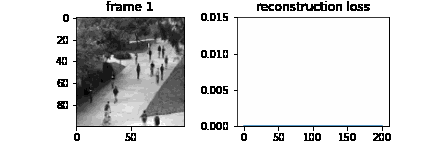

In [44]:
create_losses_animation(conv_ae, test_dataset, "losses.gif")
with open('losses.gif','rb') as file:
    display(ipyImage(file.read(), format='png'))

#### Identification of anomalous object from the video frames

The following codes will compute the differences of each pixel between original frames and the reconstructed frames (a total of 200 fames), and by comparing the differences over a patch of 4x4 pixels, and if the difference is above certain threshold, it will mark that patch with red to signify that there is an anomalous object detected within that patch. 

The 200 frames will be displayed as animated gif to better visualize the changes over time.

**Exercise**

Try changing the threshold below to adjust the sensitivity of the certain pixels being classified as anomalous.

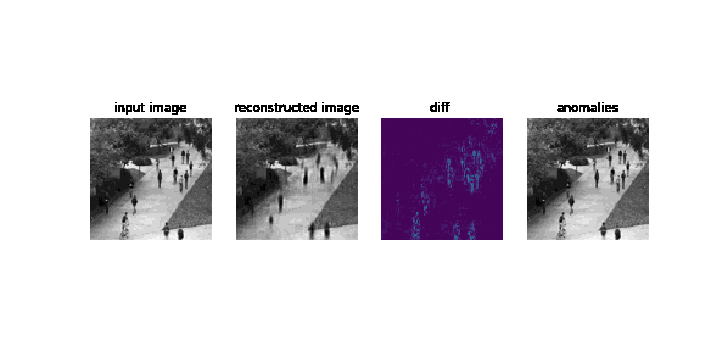

In [45]:
threshold = 4.0
identify_anomaly(conv_ae, test_dataset, "video.gif", threshold)
with open('video.gif','rb') as file:
    display(ipyImage(file.read(), format='png'))